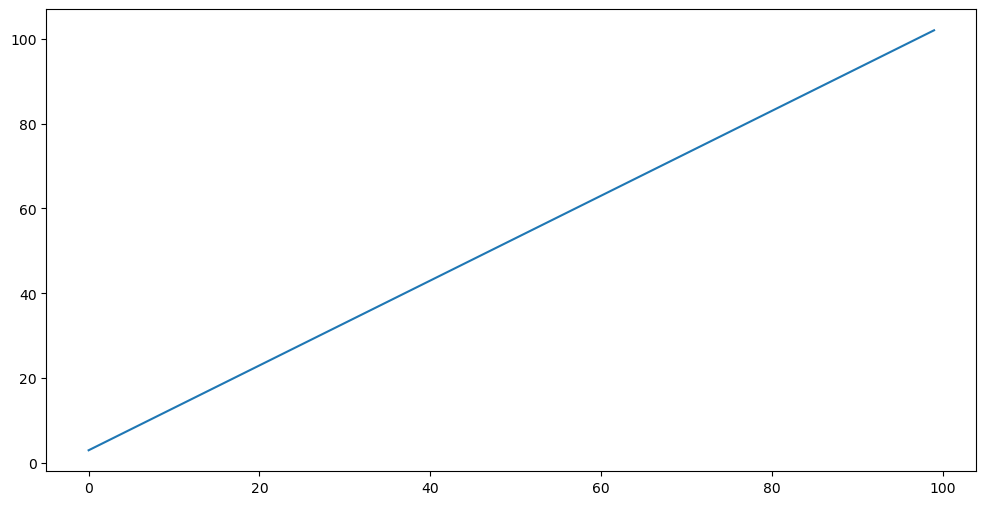

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

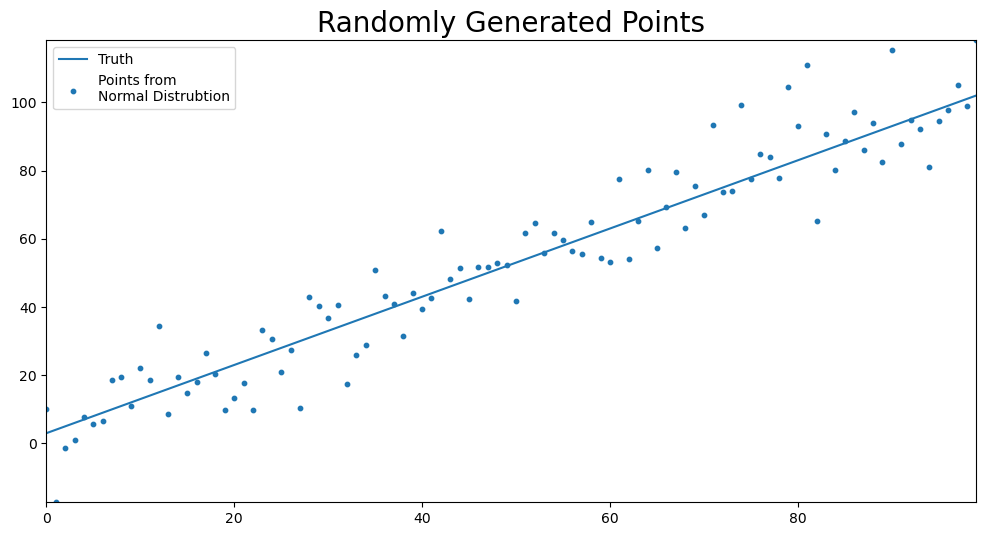

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

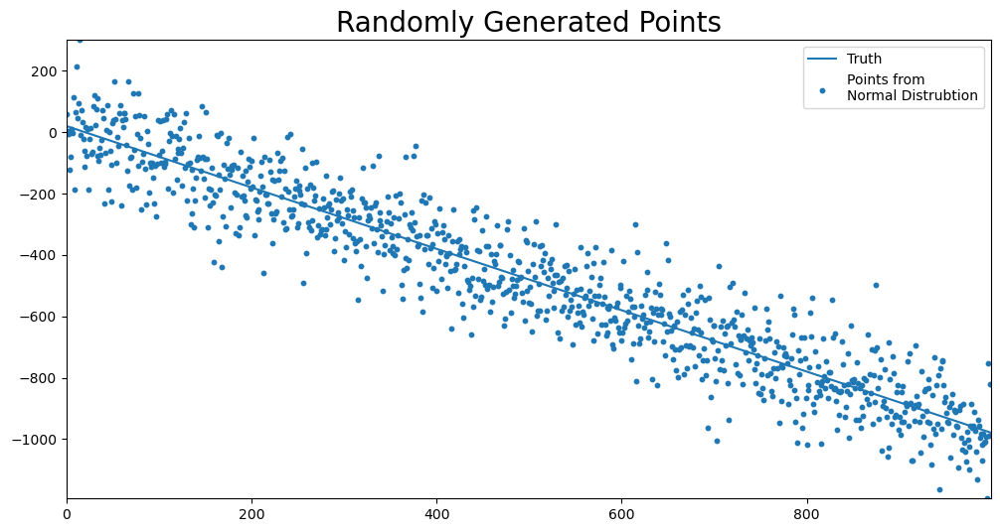

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

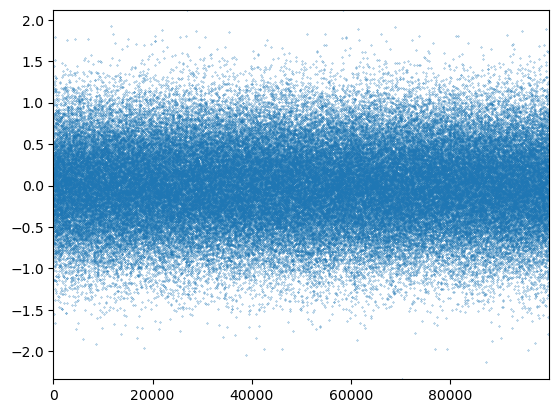

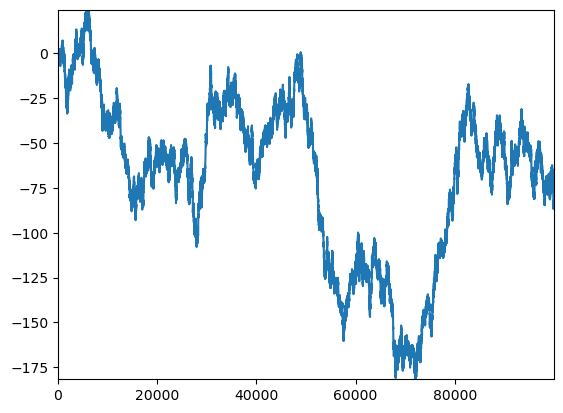

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
def run_monte_carlo(mean, sigma, num_sims, sim_dict, index):
    
    for i in range(num_sims):
        sim_dict[i] = {}
        for ix in index:
            sim_dict[i][ix] = random.normalvariate(mean, sigma)


In [6]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
index = np.arange(2000)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.035997,1.490598,-2.257177,0.184158,0.629936,0.391869,-0.561314,0.385137,0.693786,-0.940078,...,0.409826,-1.004285,1.692901,-0.361169,-0.277993,-1.134715,-0.032387,-0.109626,0.295960,1.060499
1,1.421167,0.695086,0.537266,1.444609,-0.106397,-0.763882,-0.291518,-0.806290,0.662881,-0.046518,...,0.478187,-1.325725,0.789884,2.049076,-1.223104,0.023900,-0.694562,-1.451363,-0.621888,-0.104389
2,2.428590,-0.791926,0.116752,-1.205714,0.494172,0.745241,-1.890044,-0.930244,1.244184,0.226453,...,0.317924,2.278694,-1.195064,0.205435,1.676436,0.859020,1.891002,2.107863,0.201567,0.107536
3,-2.121652,1.766709,-0.711153,0.638009,-1.093800,0.953328,0.435127,2.326839,0.528029,0.572445,...,1.886490,-1.538077,0.754293,-0.390392,-0.088964,-0.180601,-0.103358,-0.041865,0.244657,0.105093
4,-0.793886,-2.121401,-1.278238,-0.118412,-0.770123,0.933610,1.493752,-1.789222,0.652899,-0.471967,...,0.825696,0.521648,0.766315,-0.709557,0.415893,1.078184,0.450426,0.253093,0.567926,-1.482215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-1.121063,0.971217,-0.602556,0.324505,0.881881,-0.368495,-3.285785,-1.448552,0.377967,1.528596,...,-1.825919,-3.188350,-1.169543,0.786493,0.146301,0.254660,1.053214,-0.335548,0.693178,1.730845
1996,0.519245,-1.633656,-1.253535,-1.650501,-1.567829,-0.661916,0.336906,-1.929095,-0.603157,-1.502445,...,-0.645734,-0.602345,-0.421686,-0.802660,-0.809520,0.132545,-0.960804,-1.181988,0.420188,0.752546
1997,0.692222,-0.923590,0.182363,-0.465936,-0.197315,0.940135,0.755522,1.203216,-1.025803,0.164740,...,-0.079113,-1.168148,-0.117300,1.090164,0.867270,1.521190,-2.329169,0.671159,1.188827,0.586681
1998,0.302963,-0.107500,1.452621,-0.492071,1.665940,1.276331,-0.187004,-0.056095,-0.289284,0.119869,...,1.941294,-1.093877,-0.614828,1.088757,-0.083407,-0.423362,1.884479,-1.104347,-0.592564,1.069058


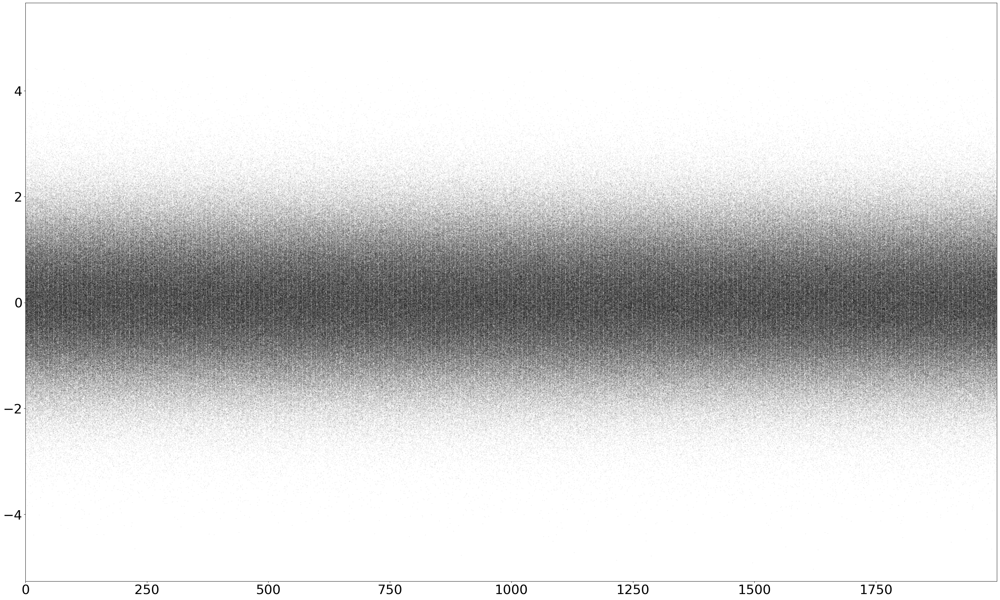

In [7]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, ls = " ", marker=".", markersize = .2, 
                            color ="k", alpha = .5, ax = ax)

plt.show()

C:\Users\JLCat\AppData\Local\Temp\ipykernel_32800\667913757.py:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])


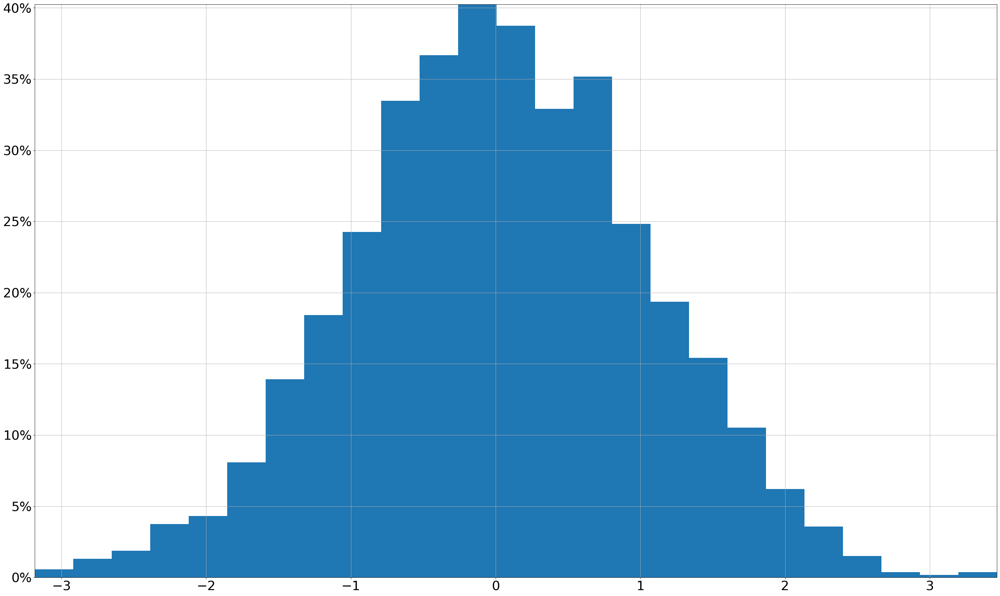

In [8]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [9]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 2000
index = np.arange(periods)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).cumsum()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.707545,0.060550,0.868770,-0.870805,-0.370830,0.664677,0.791632,-0.288661,0.168718,0.258355,...,-0.267244,0.102387,0.256411,0.086234,0.260950,0.562723,0.595869,-0.372214,-0.642997,-0.152537
1,-1.178321,-0.498295,0.584683,-0.688943,0.190125,1.101152,0.091925,-0.352174,0.316068,0.504129,...,-0.036284,0.336358,0.237651,-1.129477,-0.228309,0.109019,0.543655,-0.060413,-0.606517,-1.168637
2,-0.719412,-0.504793,0.895746,-0.691231,1.066237,0.798330,0.053457,-0.428057,1.377044,-0.024062,...,-0.216301,0.097851,-0.618437,-2.078156,-0.535071,0.352134,0.396483,0.255220,0.040938,-1.347229
3,-0.818719,-0.430023,0.222638,-0.437534,1.036075,1.306368,0.484507,-0.424552,0.804605,0.024421,...,-0.674441,1.049215,0.015408,-1.492256,-0.104070,0.938529,1.103279,1.059699,-0.108245,-1.411361
4,-0.353882,-0.958107,-0.084207,-0.502630,0.788807,0.712203,0.265847,0.143354,0.478233,-0.350228,...,-0.582157,1.387905,-0.173722,-2.086377,0.627059,0.911100,0.399400,1.891386,0.198202,-0.995882
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,127.159820,96.709671,87.780570,43.279853,121.578660,126.780988,95.520708,74.324223,105.768597,88.296861,...,118.226344,69.558502,98.195451,99.148311,131.943967,118.257032,88.308915,145.066271,89.391270,111.754748
1996,127.527650,97.213776,88.101231,42.567496,121.757380,127.237128,95.575146,73.315735,105.938665,88.865345,...,118.017909,69.381016,98.432391,99.172897,132.111335,117.889764,88.669914,145.007846,88.703277,111.727920
1997,128.075718,96.590658,88.180811,42.808221,121.902685,126.425556,95.173281,72.887594,107.022634,89.354664,...,118.256024,69.914920,98.968161,98.541843,131.281986,117.867801,89.291419,145.001205,88.411512,111.326919
1998,128.307517,95.961158,88.176491,42.552938,121.808472,126.878886,94.219286,72.596953,106.769234,89.804634,...,118.251755,69.764903,99.548729,98.038406,130.227215,118.774984,89.355898,145.753587,88.734417,111.791072


In [10]:
def plot_monte_carlo_sim(sim_data,  title = None, logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop("mean", inplace = False, axis = 1).plot.line(
            legend=False, ls = "", marker =".", markersize = .1, color = "k", 
        alpha = .05, logy = logy, ax = ax)
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

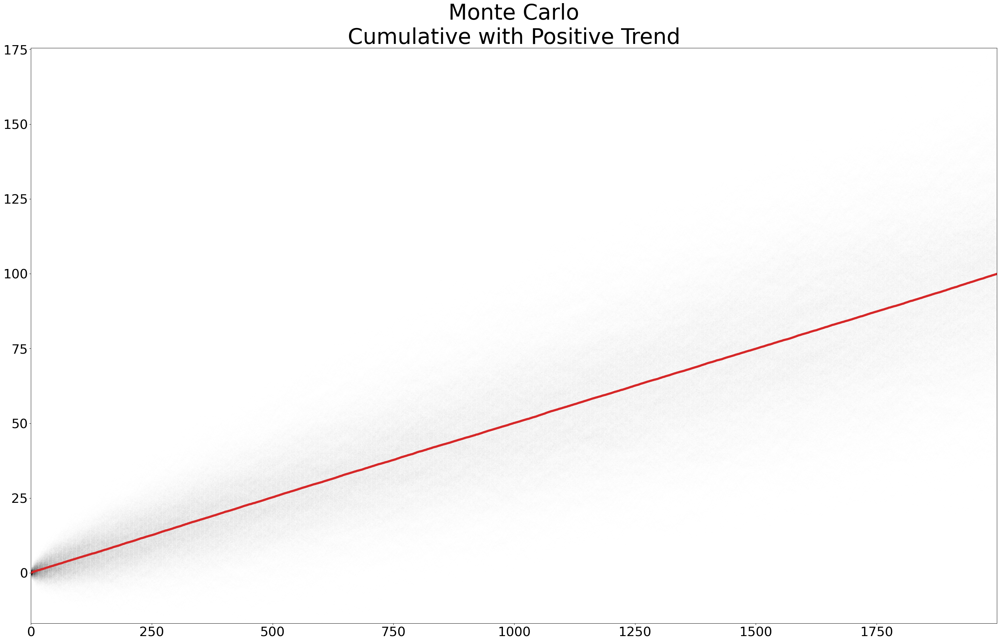

In [11]:
plot_monte_carlo_sim(monte_carlo_sim_df,  
    title = "Monte Carlo\nCumulative with Positive Trend", logy = False)


### Calculating Expected Value

In [12]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0        0.048657
1        0.101666
2        0.150554
3        0.227910
4        0.290875
          ...    
1995    99.743830
1996    99.798822
1997    99.833770
1998    99.883296
1999    99.940500
Name: mean, Length: 2000, dtype: float64

### Simulating Changes in Portfolio Values

In [15]:
import pandas_datareader.data as web
import datetime
import yfinance  as yf
yf.pdr_override()

start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = "MSFT", "AAPL", "IBM", "GOOG"
for name in stocks:
    data_dict[name] =web.get_data_yahoo(name, start, end)

# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


In [16]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072811,-0.004366,0.028109
...,...,...,...,...
2023-05-08,-0.006438,-0.000403,-0.002022,0.019065
2023-05-09,-0.005346,-0.009971,-0.018071,-0.002772
2023-05-10,0.017296,0.010421,0.007015,0.040207


In [17]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace =True)
close_data_normalized

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,1.001496,1.019118,0.987212,0.954615
2005-01-06,1.000374,1.019908,0.984143,0.930146
2005-01-07,0.997382,1.094169,0.979847,0.956292
...,...,...,...,...
2023-05-08,11.542633,153.515499,1.320475,21.438646
2023-05-09,11.480928,151.984771,1.296612,21.379227
2023-05-10,11.679506,153.568585,1.305708,22.238832


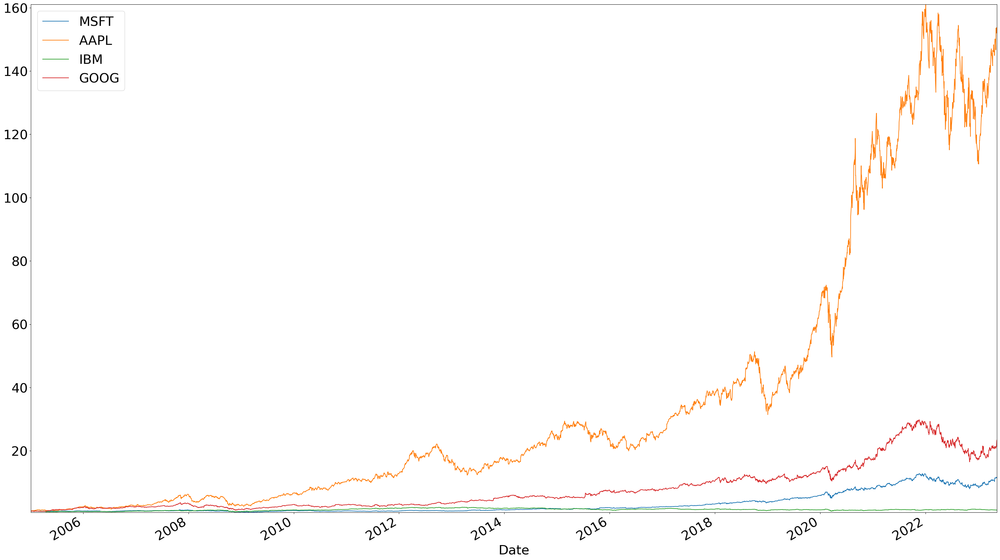

In [18]:
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax = ax)
plt.show()
plt.close()

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [19]:
mean_var_df = pd.DataFrame(
    {"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
        1 / close_data_normalized["MSFT"].count()) - 1, 
                            "sigma" : close_data_pct_change.std()})
mean_var_df

,mean,sigma
MSFT,0.000529,0.017421
AAPL,0.001088,0.020764
IBM,0.000058,0.014540
GOOG,0.000682,0.019052


In [20]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock]   
    run_monte_carlo(mean, 
                    sigma, 
                    num_sims, 
                    monte_carlo_sim_dict[stock], 
                    dates)
#    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dfs = {stock: pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod() for stock in stocks}

In [21]:
monte_carlo_sim_dfs

{'MSFT':                   0         1          2         3          4         5    \
 2005-01-03   1.007068  1.001503   0.991298  0.978309   0.990641  1.010266   
 2005-01-04   1.016652  0.969674   1.015538  0.991541   0.976739  1.003384   
 2005-01-05   1.032746  0.961208   1.007735  0.996099   0.993950  1.003429   
 2005-01-06   1.061500  0.956488   0.981433  1.000398   0.985390  1.009176   
 2005-01-07   1.055302  0.953589   0.992904  0.983832   0.973928  1.016324   
 ...               ...       ...        ...       ...        ...       ...   
 2023-05-08  19.876477  1.678814   9.969915  9.426424  40.113002  1.523032   
 2023-05-09  19.645373  1.683594  10.002597  9.554734  39.088481  1.526238   
 2023-05-10  19.238147  1.636042   9.997308  9.625844  38.889503  1.523705   
 2023-05-11  18.606022  1.594394   9.923399  9.673112  40.389891  1.510175   
 2023-05-12  18.704686  1.580825   9.957295  9.623142  40.728622  1.481588   
 
                   6         7          8         9   

In [22]:
def plot_monte_carlo_sim(sim_data, 
                         observed_data = None, 
                         title = None, 
                         logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)    
    index = sim_data.index
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop(["mean"], inplace = False, axis = 1).plot.line(
            legend=False, marker =".",
        markersize = .1, 
        color = "k", 
        alpha = .05, 
        logy = logy, 
        ax = ax)
    if observed_data is not None:
        observed_data.plot.line(legend = False, 
                                color = "C2", 
                                linewidth = 5, 
                                logy = logy, 
                                ax = ax)
    
        # find x coordinate of lowest value observed
        obs_text_x = observed_data[observed_data == observed_data.min()].index
        plt.text(obs_text_x, observed_data.loc[obs_text_x] * .7,
                 "Observed", fontsize = 70, color = "C2")
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    plt.text(index[-400], sim_data["mean"].iloc[-400] * 1.5, "Exp\nVal",
            fontsize = 70, color = "C3")
   
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

In [23]:
monte_carlo_sim_dfs[stock].median(axis = 1)

2005-01-03     1.000263
2005-01-04     0.998495
2005-01-05     0.999911
2005-01-06     1.000142
2005-01-07     1.000667
                ...    
2023-05-08    11.938776
2023-05-09    11.883730
2023-05-10    11.870557
2023-05-11    11.809664
2023-05-12    11.837402
Length: 4622, dtype: float64

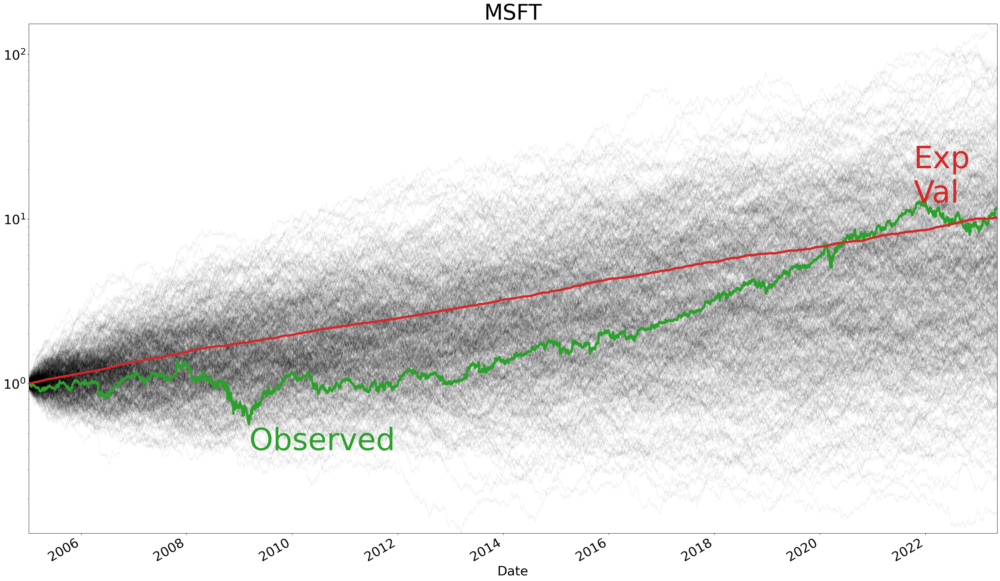

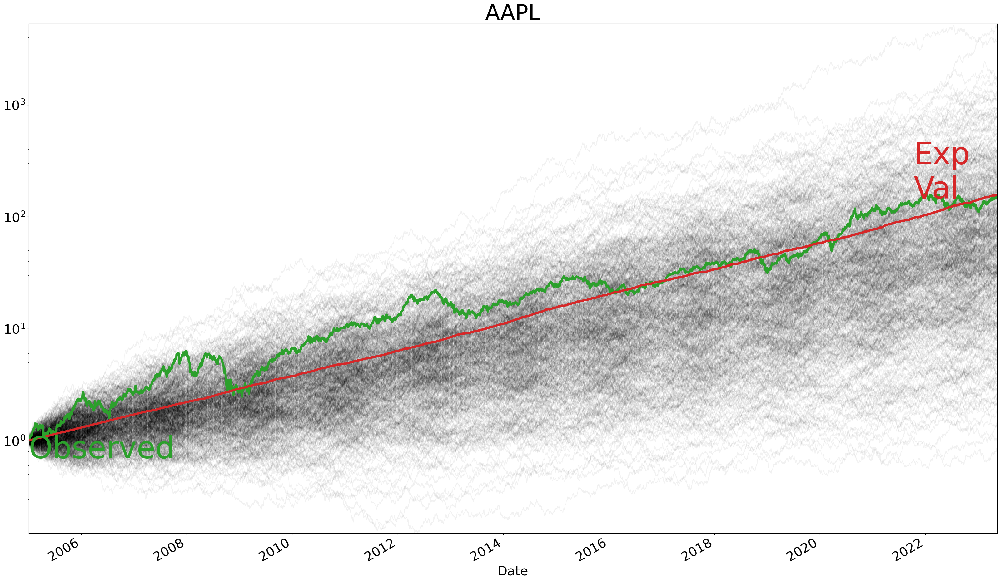

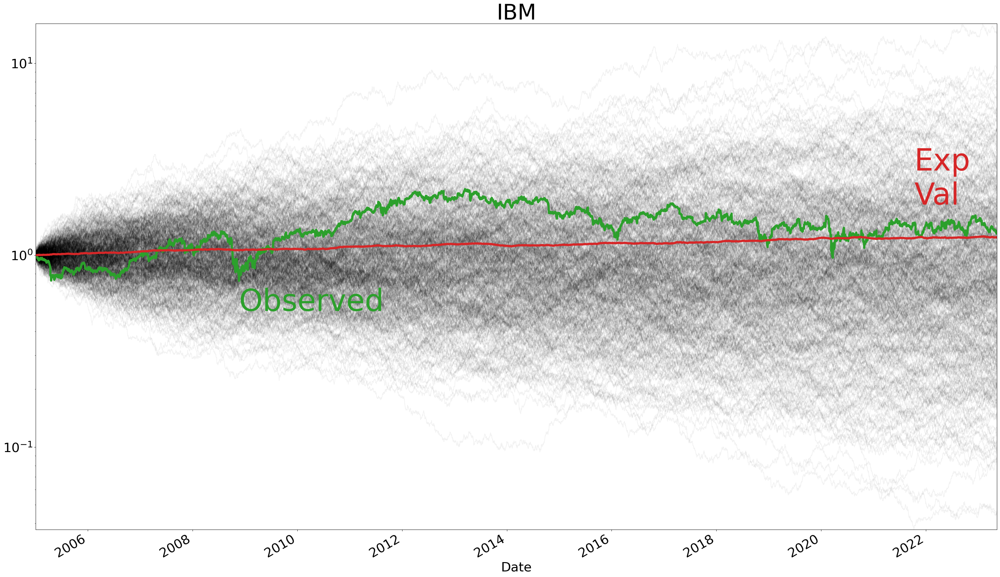

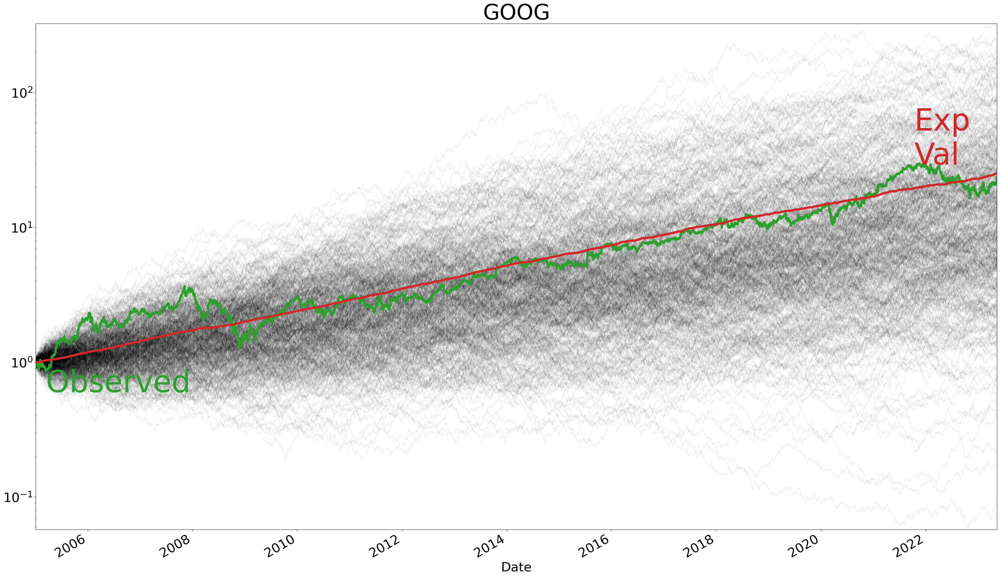

In [24]:
for stock in stocks:
    plot_monte_carlo_sim(monte_carlo_sim_dfs[stock], 
                         close_data_normalized[stock], 
                         stock, 
                         logy= True)


## Calculate Portfolio Return

In [25]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [26]:
ex_return = pd.DataFrame(close_data_normalized.apply(lambda x :x.mul(portfolio_weights[x.name]),
                                                     axis = 0).sum(axis=1),
                                                    columns = ["Portfolio Return"])
close_data_normalized["Portfolio Return"] = ex_return
close_data_normalized

,MSFT,AAPL,IBM,GOOG,Portfolio Return
Date,,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499,0.990692
2005-01-05,1.001496,1.019118,0.987212,0.954615,0.990610
2005-01-06,1.000374,1.019908,0.984143,0.930146,0.983643
2005-01-07,0.997382,1.094169,0.979847,0.956292,1.006923
...,...,...,...,...,...
2023-05-08,11.542633,153.515499,1.320475,21.438646,46.954313
2023-05-09,11.480928,151.984771,1.296612,21.379227,46.535385
2023-05-10,11.679506,153.568585,1.305708,22.238832,47.198158


<AxesSubplot:xlabel='Date'>

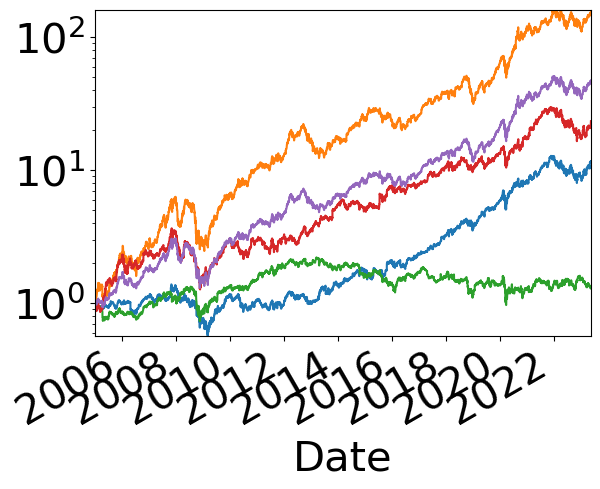

In [27]:
close_data_normalized.plot.line(legend=False, logy = True)

In [28]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001298
...,...
2023-05-08,0.001395
2023-05-09,-0.008922
2023-05-10,0.014242


In [29]:
mean_var_df = pd.DataFrame({"mean": (
    ex_return.iloc[-1] / ex_return.iloc[0]) **(
        1 / ex_return["Portfolio Return"].count()) -1,
                           "sigma" : ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000834,0.01678


In [30]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]
run_monte_carlo(mean, 
                sigma, 
                num_sims, 
                monte_carlo_sim_dict, 
                dates)
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,0.993403,1.002651,1.009349,1.013459,1.005134,0.978647,1.007614,1.009710,0.977436,0.988385,...,1.046508,1.011628,0.973423,0.987299,0.980127,0.981168,1.030956,1.006729,1.025216,0.971737
2005-01-04,0.996726,1.013927,0.994721,1.004591,1.003738,0.997672,0.996514,1.027163,0.980518,0.971582,...,1.037281,0.981476,0.962158,1.004747,0.977040,0.976963,1.027397,1.003668,1.020773,0.970721
2005-01-05,1.000281,1.016121,1.009370,1.014046,1.008391,1.016859,0.966425,1.017826,0.981371,0.976918,...,1.026926,1.008028,0.957672,1.014547,0.978491,0.996805,0.993543,1.000356,1.013201,0.997643
2005-01-06,0.969842,1.055535,0.999172,1.004041,1.009855,0.999635,0.974397,1.017959,0.976263,0.977993,...,1.032351,1.015174,0.959211,1.042440,0.982902,0.998095,0.991099,1.007268,1.018485,0.993522
2005-01-07,0.969836,1.048553,0.989875,0.970993,0.999200,0.990861,1.005185,1.009805,0.991254,0.979215,...,1.034560,0.989299,0.973055,1.057985,0.991013,1.002671,1.006480,1.004678,0.974772,1.007067
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-08,16.314607,30.442998,36.351590,19.029008,16.311806,62.124136,114.345820,14.462120,111.358651,42.910624,...,5.039847,24.979848,115.361641,5.618033,24.170915,66.881827,11.957595,4.517269,8.284580,30.708808
2023-05-09,15.924701,29.763778,36.218000,19.212738,16.666560,61.881531,114.337113,14.663158,114.677950,42.269726,...,5.182446,25.679443,118.009703,5.812956,24.186147,67.372880,11.945730,4.497319,8.348064,30.954452
2023-05-10,15.959387,28.913789,35.686925,19.532556,17.041937,61.030600,114.891587,14.564263,113.700628,42.858320,...,5.244091,25.789982,117.119801,5.985935,23.759338,64.691844,11.910011,4.531101,8.191109,31.787494
2023-05-11,15.869315,28.481203,35.699766,19.653431,17.256612,63.725354,119.435169,14.575323,113.817462,43.114104,...,5.258219,25.597646,114.641919,6.064363,23.499491,64.111677,12.367610,4.540935,8.051017,31.683271


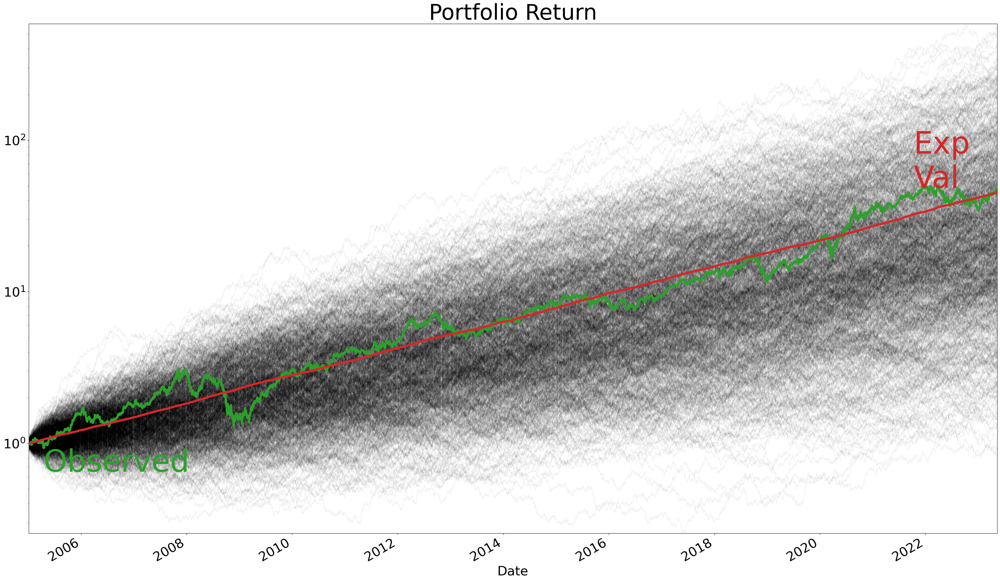

In [31]:
plot_monte_carlo_sim(monte_carlo_sim_df, 
                     ex_return["Portfolio Return"], 
                     "Portfolio Return", 
                     logy= True)